<a href="https://colab.research.google.com/github/lamsalshrawan/Thesis_RMC_PRnet/blob/main/Model_RMC_Thesis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#  Import necessary Libraries
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Image
from PIL import Image
from google.colab import files
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.preprocessing import RobustScaler, LabelEncoder, label_binarize, OneHotEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from imblearn.over_sampling import SMOTE
from collections import Counter
from itertools import cycle
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix, precision_recall_curve, average_precision_score
from sklearn.metrics import roc_curve, auc

In [ ]:
# Load the Excel file from Google Drive
file_path = '/content/drive/My Drive/data23march.xlsx'  # Update the path if necessary
data = pd.read_excel(file_path)
print(data.columns)

Index(['Chainage', 'CRS', 'Torque', 'PRchd', 'Thrust', 'PRnet', 'RMR', 'RMC',
       'SE', 'FPI', 'Lithology', 'Formation', 'Weathering', 'Strength'],
      dtype='object')


In [ ]:
# Drop the "Chainage" column
data = data.drop(columns=['Chainage','SE','FPI','Lithology','Formation','Weathering','Strength'])

# Print the remaining columns to verify
print(data.columns)

Index(['CRS', 'Torque', 'PRchd', 'Thrust', 'PRnet', 'RMR', 'RMC'], dtype='object')


In [ ]:
# Define features and target
X = data[['CRS', 'Torque', 'Thrust', 'PRchd', 'PRnet']]  # Replace with actual feature names
y = data['RMC']  # Replace with actual target column name

In [ ]:
# Label Encoding for categorical target variable
label_encoder = LabelEncoder()
y_encoded = label_encoder.fit_transform(y)


In [ ]:
# Robust Scaling for feature set
scaler = RobustScaler()
X_scaled = scaler.fit_transform(X)

# Train-Test Split (80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_encoded, test_size=0.2, random_state=42, stratify=y)

# Apply SMOTE to balance dataset
smote = SMOTE()
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)
print(f"Class distribution after SMOTE: {Counter(y_train_smote)}")

# Define classifiers
classifiers = {
    'SVM': SVC(probability=True),
    'Decision Tree': DecisionTreeClassifier(),
    'KNN': KNeighborsClassifier(),
    'Random Forest': RandomForestClassifier()
}


Class distribution after SMOTE: Counter({np.int64(0): 1364, np.int64(1): 1364, np.int64(2): 1364})


In [ ]:
# **Optimized Hyperparameters (WITHOUT SMOTE)**
best_params_no_smote = {
    "SVM": {'C': 10, 'gamma': 'scale', 'kernel': 'rbf'},
    "Decision Tree": {'criterion': 'gini', 'max_depth': 5, 'min_samples_leaf': 10, 'min_samples_split': 2},
    "KNN": {'algorithm': 'auto', 'n_neighbors': 15, 'p': 1, 'weights': 'distance'},
    "Random Forest": {'bootstrap': True, 'max_depth': 10, 'max_features': 'log2', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 50}
}

# **Optimized Hyperparameters (WITH SMOTE)**
best_params_smote = {
    "SVM": {'C': 40, 'gamma': 'auto', 'kernel': 'rbf'},
    "Decision Tree": {'criterion': 'gini', 'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 2},
    "KNN": {'algorithm': 'auto', 'n_neighbors': 5, 'p': 2, 'weights': 'distance'},
    "Random Forest": {'bootstrap': True, 'max_depth': 20, 'max_features': 'log2', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}
}

# **Define models with optimized parameters**
models_no_smote = {
    "SVM": SVC(**best_params_no_smote["SVM"], probability=True),
    "Decision Tree": DecisionTreeClassifier(**best_params_no_smote["Decision Tree"]),
    "KNN": KNeighborsClassifier(**best_params_no_smote["KNN"]),
    "Random Forest": RandomForestClassifier(**best_params_no_smote["Random Forest"])
}

models_smote = {
    "SVM": SVC(**best_params_smote["SVM"], probability=True),
    "Decision Tree": DecisionTreeClassifier(**best_params_smote["Decision Tree"]),
    "KNN": KNeighborsClassifier(**best_params_smote["KNN"]),
    "Random Forest": RandomForestClassifier(**best_params_smote["Random Forest"])
}



In [ ]:
# Function to compute metrics per class
def compute_metrics(y_true, y_pred):
    acc = round(accuracy_score(y_true, y_pred), 3)  # Overall accuracy (rounded to 3 decimals)
    pre = np.round(precision_score(y_true, y_pred, average=None), 2)  # Per-class precision
    rec = np.round(recall_score(y_true, y_pred, average=None), 2)  # Per-class recall
    f1 = np.round(f1_score(y_true, y_pred, average=None), 2)  # Per-class F1-score
    return acc, pre, rec, f1

# Initialize dictionary to store evaluation metrics
results = {
    'Model': [],
    'Rock Mass Class': [],
    'ACC (Without SMOTE)': [],
    'ACC (With SMOTE)': [],
    'PRE (Without SMOTE)': [],
    'PRE (With SMOTE)': [],
    'REC (Without SMOTE)': [],
    'REC (With SMOTE)': [],
    'F1-Score (Without SMOTE)': [],
    'F1-Score (With SMOTE)': []
}

# List of rock mass classes
rock_mass_classes = ['Class III', 'Class IV', 'Class V']

# Compute metrics WITHOUT SMOTE
for model_name, model in models_no_smote.items():
    model.fit(X_train, y_train)
    y_pred_without = model.predict(X_test)
    acc_without, pre_without, rec_without, f1_without = compute_metrics(y_test, y_pred_without)

    # Store results
    for i, class_label in enumerate(rock_mass_classes):
        results['Model'].append(model_name)
        results['Rock Mass Class'].append(class_label)
        results['ACC (Without SMOTE)'].append(acc_without)  # Accuracy is the same for all classes
        results['PRE (Without SMOTE)'].append(pre_without[i])
        results['REC (Without SMOTE)'].append(rec_without[i])
        results['F1-Score (Without SMOTE)'].append(f1_without[i])

# Compute metrics WITH SMOTE
for model_name, model in models_smote.items():
    model.fit(X_train_smote, y_train_smote)
    y_pred_with = model.predict(X_test)
    acc_with, pre_with, rec_with, f1_with = compute_metrics(y_test, y_pred_with)

    # Update results
    for i, class_label in enumerate(rock_mass_classes):
        results['ACC (With SMOTE)'].append(acc_with)  # Accuracy is the same for all classes
        results['PRE (With SMOTE)'].append(pre_with[i])
        results['REC (With SMOTE)'].append(rec_with[i])
        results['F1-Score (With SMOTE)'].append(f1_with[i])

# Convert results to a pandas DataFrame
results_df = pd.DataFrame(results)

# Display results
display(results_df)

# Save results to an Excel file
file_path = 'performance_comparison_with_without_smote.xlsx'
results_df.to_excel(file_path, index=False)

# Download the file (for Google Colab)
files.download(file_path)



,Model,Rock Mass Class,ACC (Without SMOTE),ACC (With SMOTE),PRE (Without SMOTE),PRE (With SMOTE),REC (Without SMOTE),REC (With SMOTE),F1-Score (Without SMOTE),F1-Score (With SMOTE)
0,SVM,Class III,0.740,0.701,0.78,0.79,0.82,0.79,0.80,0.79
1,SVM,Class IV,0.740,0.701,0.70,0.68,0.69,0.56,0.69,0.62
2,SVM,Class V,0.740,0.701,0.67,0.33,0.27,0.83,0.38,0.48
3,Decision Tree,Class III,0.742,0.680,0.81,0.78,0.78,0.74,0.79,0.76
4,Decision Tree,Class IV,0.742,0.680,0.67,0.65,0.75,0.60,0.71,0.62
5,Decision Tree,Class V,0.742,0.680,0.60,0.31,0.30,0.67,0.40,0.43
6,KNN,Class III,0.740,0.690,0.78,0.79,0.81,0.74,0.79,0.76
7,KNN,Class IV,0.740,0.690,0.69,0.66,0.70,0.62,0.70,0.64
8,KNN,Class V,0.740,0.690,0.75,0.32,0.30,0.73,0.43,0.45
9,Random Forest,Class III,0.764,0.729,0.81,0.81,0.82,0.79,0.81,0.80


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# **Function to plot recall-based confusion matrices (without color bar)**
def plot_recall_based_confusion_matrices(confusion_matrices, class_labels, title_prefix=""):
    plt.figure(figsize=(14, 12), dpi=800)  # **Set DPI to 800**

    # **Model name replacements for cleaner titles**
    model_name_mapping = {"Random Forest": "RF", "Decision Tree": "DT", "SVM": "SVM", "KNN": "KNN"}

    for i, (model_name, conf_matrix) in enumerate(confusion_matrices.items()):
        # **Replace model name if in mapping, otherwise keep the same**
        model_display_name = model_name_mapping.get(model_name, model_name)

        # **Ensure correct row normalization (Handling Division by Zero)**
        row_sums = conf_matrix.sum(axis=1, keepdims=True)
        recall_matrix = np.divide(conf_matrix.astype(float), row_sums, where=row_sums != 0)  # Avoid division by zero

        # **Plot Heatmap (Color Bar Removed)**
        plt.subplot(2, 2, i + 1)
        sns.heatmap(
            recall_matrix, annot=True, fmt='.2f', cmap='RdBu', cbar=False,  # **Formatted to .2f**
            xticklabels=class_labels, yticklabels=class_labels, linewidths=0.5, linecolor='black',
            annot_kws={"size": 22}  # **Increased font size inside the boxes**
        )

        # **Formatting**
        plt.xlabel('Predicted Class', fontsize=22)
        plt.ylabel('Actual Class', fontsize=22)
        plt.title(f"{model_display_name} {title_prefix}", fontsize=22)  # Title formatting
        plt.xticks(fontsize=22)
        plt.yticks(fontsize=22)

    plt.tight_layout()
    plt.show()

# **Define Class Labels (Ensure Consistency)**
class_labels = rock_mass_classes

# **Use Previously Computed Confusion Matrices for Recall-Based Analysis**
confusion_matrices_no_smote = {
    model_name: confusion_matrix(y_test, model.predict(X_test))
    for model_name, model in models_no_smote.items()
}

confusion_matrices_smote = {
    model_name: confusion_matrix(y_test, model.predict(X_test))
    for model_name, model in models_smote.items()
}

# **Plot Recall-Based Confusion Matrices (Without SMOTE)**
print("📌 Recall-Based Confusion Matrices Without SMOTE")
plot_recall_based_confusion_matrices(confusion_matrices_no_smote, class_labels, title_prefix="")

# **Plot Recall-Based Confusion Matrices (With SMOTE)**
print("📌 Recall-Based Confusion Matrices With SMOTE")
plot_recall_based_confusion_matrices(confusion_matrices_smote, class_labels, title_prefix="(SMOTE)")


📌 Recall-Based Confusion Matrices Without SMOTE


📌 Recall-Based Confusion Matrices With SMOTE


In [ ]:
# Compute confusion matrix and recall per class for each model
def compute_confusion_matrix_and_recall(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred)
    recall = np.round(recall_score(y_true, y_pred, average=None), 2)  # Per-class recall rounded to 2 decimals
    return cm, recall

# Dictionary to store confusion matrices and recall results
confusion_results = {
    'Model': [],
    'Rock Mass Class': [],
    'Confusion Matrix (Without SMOTE)': [],
    'Recall (Without SMOTE)': [],
    'Confusion Matrix (With SMOTE)': [],
    'Recall (With SMOTE)': []
}

# Compute confusion matrix and recall WITHOUT SMOTE
for model_name, model in models_no_smote.items():
    y_pred_without = model.predict(X_test)
    cm_without, recall_without = compute_confusion_matrix_and_recall(y_test, y_pred_without)

    # Store results
    for i, class_label in enumerate(rock_mass_classes):
        confusion_results['Model'].append(model_name)
        confusion_results['Rock Mass Class'].append(class_label)
        confusion_results['Confusion Matrix (Without SMOTE)'].append(cm_without)
        confusion_results['Recall (Without SMOTE)'].append(recall_without[i])

# Compute confusion matrix and recall WITH SMOTE
for model_name, model in models_smote.items():
    y_pred_with = model.predict(X_test)
    cm_with, recall_with = compute_confusion_matrix_and_recall(y_test, y_pred_with)

    # Update results
    for i, class_label in enumerate(rock_mass_classes):
        confusion_results['Confusion Matrix (With SMOTE)'].append(cm_with)
        confusion_results['Recall (With SMOTE)'].append(recall_with[i])

# Convert confusion results to a pandas DataFrame
confusion_results_df = pd.DataFrame(confusion_results)

# Display confusion results
display(confusion_results_df)

# Save confusion results to an Excel file
confusion_file_path = 'confusion_matrix_with_without_smote.xlsx'
confusion_results_df.to_excel(confusion_file_path, index=False)

# Download the confusion matrix file (for Google Colab)
files.download(confusion_file_path)

,Model,Rock Mass Class,Confusion Matrix (Without SMOTE),Recall (Without SMOTE),Confusion Matrix (With SMOTE),Recall (With SMOTE)
0,SVM,Class III,"[[279, 61, 1], [78, 183, 3], [3, 19, 8]]",0.82,"[[271, 65, 5], [70, 149, 45], [1, 4, 25]]",0.79
1,SVM,Class IV,"[[279, 61, 1], [78, 183, 3], [3, 19, 8]]",0.69,"[[271, 65, 5], [70, 149, 45], [1, 4, 25]]",0.56
2,SVM,Class V,"[[279, 61, 1], [78, 183, 3], [3, 19, 8]]",0.27,"[[271, 65, 5], [70, 149, 45], [1, 4, 25]]",0.83
3,Decision Tree,Class III,"[[265, 75, 1], [62, 197, 5], [0, 21, 9]]",0.78,"[[254, 78, 9], [71, 158, 35], [2, 8, 20]]",0.74
4,Decision Tree,Class IV,"[[265, 75, 1], [62, 197, 5], [0, 21, 9]]",0.75,"[[254, 78, 9], [71, 158, 35], [2, 8, 20]]",0.60
5,Decision Tree,Class V,"[[265, 75, 1], [62, 197, 5], [0, 21, 9]]",0.30,"[[254, 78, 9], [71, 158, 35], [2, 8, 20]]",0.67
6,KNN,Class III,"[[275, 65, 1], [76, 186, 2], [3, 18, 9]]",0.81,"[[252, 80, 9], [63, 164, 37], [3, 5, 22]]",0.74
7,KNN,Class IV,"[[275, 65, 1], [76, 186, 2], [3, 18, 9]]",0.70,"[[252, 80, 9], [63, 164, 37], [3, 5, 22]]",0.62
8,KNN,Class V,"[[275, 65, 1], [76, 186, 2], [3, 18, 9]]",0.30,"[[252, 80, 9], [63, 164, 37], [3, 5, 22]]",0.73
9,Random Forest,Class III,"[[279, 61, 1], [65, 195, 4], [2, 17, 11]]",0.82,"[[271, 64, 6], [63, 173, 28], [2, 9, 19]]",0.79


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# **Function to compute accuracy metrics for a classifier (Using Previously Trained Models)**
def compute_accuracy_metrics(model, X_train, y_train, X_test, y_test):
    acc_train = round(model.score(X_train, y_train) * 100, 3)  # Training Accuracy %
    acc_test = round(model.score(X_test, y_test) * 100, 3)    # Testing Accuracy %
    diff = round(acc_train - acc_test, 3)                     # Difference between training and testing accuracy
    ratio = round(acc_train / acc_test, 3) if acc_test != 0 else "N/A"  # Avoid division by zero
    return acc_train, acc_test, diff, ratio

# **Initialize dictionary to store results**
accuracy_results = {
    'Classifier': [],
    'ACCtrain (Without SMOTE)': [],
    'ACCtest (Without SMOTE)': [],
    'ACCtrain - ACCtest (Without SMOTE)': [],
    'ACCtrain / ACCtest (Without SMOTE)': [],
    'ACCtrain (With SMOTE)': [],
    'ACCtest (With SMOTE)': [],
    'ACCtrain - ACCtest (With SMOTE)': [],
    'ACCtrain / ACCtest (With SMOTE)': []
}

# **Evaluate Classifiers (Without SMOTE) - Using Previously Trained Models**
for model_name, model in models_no_smote.items():
    acc_train, acc_test, diff, ratio = compute_accuracy_metrics(model, X_train, y_train, X_test, y_test)

    # Store results
    accuracy_results['Classifier'].append(model_name)
    accuracy_results['ACCtrain (Without SMOTE)'].append(acc_train)
    accuracy_results['ACCtest (Without SMOTE)'].append(acc_test)
    accuracy_results['ACCtrain - ACCtest (Without SMOTE)'].append(diff)
    accuracy_results['ACCtrain / ACCtest (Without SMOTE)'].append(ratio)

# **Evaluate Classifiers (With SMOTE) - Using Previously Trained Models**
for model_name, model in models_smote.items():
    acc_train, acc_test, diff, ratio = compute_accuracy_metrics(model, X_train_smote, y_train_smote, X_test, y_test)

    # Store results
    accuracy_results['ACCtrain (With SMOTE)'].append(acc_train)
    accuracy_results['ACCtest (With SMOTE)'].append(acc_test)
    accuracy_results['ACCtrain - ACCtest (With SMOTE)'].append(diff)
    accuracy_results['ACCtrain / ACCtest (With SMOTE)'].append(ratio)

# **Convert the results to a DataFrame**
accuracy_results_df = pd.DataFrame(accuracy_results)

print("\n📌 Classifiers Accuracy Comparison (With & Without SMOTE)")
display(accuracy_results_df)  # Display first few rows of results

# **Save results to an Excel file**
file_path = 'classifiers_comparison_with_without_smote.xlsx'
accuracy_results_df.to_excel(file_path, index=False)

# **Download the file (for Google Colab)**
from google.colab import files
files.download(file_path)  # Allows downloading the file


📌 Classifiers Accuracy Comparison (With & Without SMOTE)


,Classifier,ACCtrain (Without SMOTE),ACCtest (Without SMOTE),ACCtrain - ACCtest (Without SMOTE),ACCtrain / ACCtest (Without SMOTE),ACCtrain (With SMOTE),ACCtest (With SMOTE),ACCtrain - ACCtest (With SMOTE),ACCtrain / ACCtest (With SMOTE)
0,SVM,78.132,74.016,4.116,1.056,80.499,70.079,10.420,1.149
1,Decision Tree,78.251,74.173,4.078,1.055,87.512,68.031,19.481,1.286
2,KNN,100.000,74.016,25.984,1.351,100.000,68.976,31.024,1.450
3,Random Forest,88.771,76.378,12.393,1.162,99.878,72.913,26.965,1.370


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# **Initialize dictionary to store evaluation metrics**
evaluation_metrics = {
    'Classifier': [],
    'Accuracy (Without SMOTE)': [],
    'Accuracy (With SMOTE)': [],
    'Precision (Without SMOTE)': [],
    'Precision (With SMOTE)': [],
    'Recall (Without SMOTE)': [],
    'Recall (With SMOTE)': [],
    'F1-Score (Without SMOTE)': [],
    'F1-Score (With SMOTE)': [],
    'ROC AUC (Without SMOTE)': [],
    'ROC AUC (With SMOTE)': []
}

# **Evaluate models WITHOUT SMOTE (Using Previously Trained Models)**
for model_name, model in models_no_smote.items():
    y_pred_no_smote = model.predict(X_test)  # Use previously trained model predictions

    # Compute evaluation metrics
    accuracy_no_smote = round(accuracy_score(y_test, y_pred_no_smote), 3)
    precision_no_smote = round(precision_score(y_test, y_pred_no_smote, average='weighted'), 3)
    recall_no_smote = round(recall_score(y_test, y_pred_no_smote, average='weighted'), 3)
    f1_no_smote = round(f1_score(y_test, y_pred_no_smote, average='weighted'), 3)

    # Compute ROC AUC only for models with predict_proba
    if hasattr(model, "predict_proba"):
        y_proba_no_smote = model.predict_proba(X_test)
        roc_auc_no_smote = round(roc_auc_score(label_binarize(y_test, classes=np.unique(y_test)), y_proba_no_smote,
                                               average='weighted', multi_class='ovr'), 3)
    else:
        roc_auc_no_smote = 'N/A'

    # Store results
    evaluation_metrics['Classifier'].append(model_name)
    evaluation_metrics['Accuracy (Without SMOTE)'].append(accuracy_no_smote)
    evaluation_metrics['Precision (Without SMOTE)'].append(precision_no_smote)
    evaluation_metrics['Recall (Without SMOTE)'].append(recall_no_smote)
    evaluation_metrics['F1-Score (Without SMOTE)'].append(f1_no_smote)
    evaluation_metrics['ROC AUC (Without SMOTE)'].append(roc_auc_no_smote)

# **Evaluate models WITH SMOTE (Using Previously Trained Models)**
for model_name, model in models_smote.items():
    y_pred_smote = model.predict(X_test)  # Use previously trained model predictions

    # Compute evaluation metrics
    accuracy_smote = round(accuracy_score(y_test, y_pred_smote), 3)
    precision_smote = round(precision_score(y_test, y_pred_smote, average='weighted'), 3)
    recall_smote = round(recall_score(y_test, y_pred_smote, average='weighted'), 3)
    f1_smote = round(f1_score(y_test, y_pred_smote, average='weighted'), 3)

    # Compute ROC AUC only for models with predict_proba
    if hasattr(model, "predict_proba"):
        y_proba_smote = model.predict_proba(X_test)
        roc_auc_smote = round(roc_auc_score(label_binarize(y_test, classes=np.unique(y_test)), y_proba_smote,
                                            average='weighted', multi_class='ovr'), 3)
    else:
        roc_auc_smote = 'N/A'

    # Store results
    evaluation_metrics['Accuracy (With SMOTE)'].append(accuracy_smote)
    evaluation_metrics['Precision (With SMOTE)'].append(precision_smote)
    evaluation_metrics['Recall (With SMOTE)'].append(recall_smote)
    evaluation_metrics['F1-Score (With SMOTE)'].append(f1_smote)
    evaluation_metrics['ROC AUC (With SMOTE)'].append(roc_auc_smote)

# **Convert results to DataFrame**
evaluation_metrics_df = pd.DataFrame(evaluation_metrics)

print("\n📌 Meta Classifier Evaluation Metrics (With & Without SMOTE)")
display(evaluation_metrics_df)  # Display results in Colab/Jupyter

# **Save results to an Excel file**
file_path = 'meta_classifier_evaluation_metrics_with_without_smote.xlsx'
evaluation_metrics_df.to_excel(file_path, index=False)

# **Download the file (for Google Colab)**
from google.colab import files
files.download(file_path)  # Allows direct download



📌 Meta Classifier Evaluation Metrics (With & Without SMOTE)


,Classifier,Accuracy (Without SMOTE),Accuracy (With SMOTE),Precision (Without SMOTE),Precision (With SMOTE),Recall (Without SMOTE),Recall (With SMOTE),F1-Score (Without SMOTE),F1-Score (With SMOTE),ROC AUC (Without SMOTE),ROC AUC (With SMOTE)
0,SVM,0.740,0.701,0.737,0.725,0.740,0.701,0.734,0.706,0.841,0.819
1,Decision Tree,0.742,0.680,0.743,0.701,0.742,0.680,0.739,0.687,0.817,0.762
2,KNN,0.740,0.690,0.740,0.715,0.740,0.690,0.735,0.698,0.829,0.797
3,Random Forest,0.764,0.729,0.762,0.742,0.764,0.729,0.761,0.734,0.843,0.822


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# **Model name replacements for cleaner titles** #YEDI CHALENA VANE MATHIKO CONFUSION MATRIX RUN GARNE BITTIKAI GARNE
model_name_mapping = {"Random Forest": "RF", "Decision Tree": "DT", "SVM": "SVM", "KNN": "KNN"}

# **Function to plot standard confusion matrices with new layout and design**
def plot_confusion_matrices(confusion_matrices, class_labels, title_prefix=""):
    plt.figure(figsize=(14, 12), dpi=800)  # **Set figure size and DPI to match new code**

    for i, (model_name, conf_matrix) in enumerate(confusion_matrices.items()):
        # **Replace model name if in mapping, otherwise keep the same**
        model_display_name = model_name_mapping.get(model_name, model_name)

        # **Plot Heatmap (Color Bar Removed, Standard Confusion Matrix)**
        plt.subplot(2, 2, i + 1)
        sns.heatmap(
            conf_matrix, annot=True, fmt='d', cmap='Blues', cbar=False,  # **Keep Blues cmap, use fmt='d' for raw counts**
            xticklabels=class_labels, yticklabels=class_labels, linewidths=0.5, linecolor='black',  # **Grid lines from new code**
            annot_kws={"size": 22}  # **Font size for annotations from new code**
        )

        # **Formatting (font sizes from new code)**
        plt.xlabel('Predicted Class', fontsize=22)
        plt.ylabel('Actual Class', fontsize=22)
        plt.title(f"{model_display_name} {title_prefix}", fontsize=22)  # Title formatting
        plt.xticks(fontsize=22)
        plt.yticks(fontsize=22)

    plt.tight_layout()
    plt.show()

# **Use Confusion Matrices from First Code (Stored in confusion_results_df)**
# Assuming confusion_results_df is already computed by the first code
# Extract unique confusion matrices for each model (since they're repeated for each class)

# Without SMOTE
confusion_matrices_no_smote = {}
for model_name in confusion_results_df['Model'].unique():
    # Get the first row for this model (confusion matrix is the same for all classes)
    cm = confusion_results_df[confusion_results_df['Model'] == model_name]['Confusion Matrix (Without SMOTE)'].iloc[0]
    confusion_matrices_no_smote[model_name] = cm

# With SMOTE
confusion_matrices_smote = {}
for model_name in confusion_results_df['Model'].unique():
    # Get the first row for this model (confusion matrix is the same for all classes)
    cm = confusion_results_df[confusion_results_df['Model'] == model_name]['Confusion Matrix (With SMOTE)'].iloc[0]
    confusion_matrices_smote[model_name] = cm

# **Define Class Labels (Ensure Consistency with First Code)**
class_labels = rock_mass_classes  # Use the same class labels as the first code

# **Plot Standard Confusion Matrices (Without SMOTE)**
print("📌 Standard Confusion Matrices Without SMOTE")
plot_confusion_matrices(confusion_matrices_no_smote, class_labels, title_prefix="")

# **Plot Standard Confusion Matrices (With SMOTE)**
print("📌 Standard Confusion Matrices With SMOTE")
plot_confusion_matrices(confusion_matrices_smote, class_labels, title_prefix="(SMOTE)")

📌 Standard Confusion Matrices Without SMOTE


📌 Standard Confusion Matrices With SMOTE


In [ ]:
# **Precompute predicted probabilities for all models**
y_proba_no_smote = {model_name: model.predict_proba(X_test) for model_name, model in models_no_smote.items()}
y_proba_smote = {model_name: model.predict_proba(X_test) for model_name, model in models_smote.items()}

# **Function to plot ROC-AUC curves in a 2x2 grid (Including Micro & Macro Averages)**
def plot_roc_auc_multiclass_2x2(models, y_proba_dict, y_test, n_classes, title_prefix=""):
    fig, axes = plt.subplots(2, 2, figsize=(14, 12), dpi=800)  # **Set DPI to 800**
    axes = axes.ravel()  # Flatten axes for easy iteration

    # **Binarize y_test for multiclass ROC-AUC**
    y_test_binarized = label_binarize(y_test, classes=np.unique(y_test))
    class_labels = ['Class III', 'Class IV', 'Class V']

    # **Model name replacements**
    model_name_mapping = {"Random Forest": "RF", "Decision Tree": "DT"}

    for i, (model_name, y_score) in enumerate(y_proba_dict.items()):
        # **Replace model name if in mapping, otherwise keep the same**
        model_display_name = model_name_mapping.get(model_name, model_name)

        fpr, tpr, roc_auc = {}, {}, {}

        # **Compute ROC Curve & AUC for Each Class**
        for j in range(n_classes):
            fpr[j], tpr[j], _ = roc_curve(y_test_binarized[:, j], y_score[:, j])
            roc_auc[j] = auc(fpr[j], tpr[j])

        # **Compute Micro-Average ROC**
        fpr["micro"], tpr["micro"], _ = roc_curve(y_test_binarized.ravel(), y_score.ravel())
        roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

        # **Compute Macro-Average ROC**
        all_fpr = np.unique(np.concatenate([fpr[j] for j in range(n_classes)]))
        mean_tpr = np.zeros_like(all_fpr)
        for j in range(n_classes):
            mean_tpr += np.interp(all_fpr, fpr[j], tpr[j])
        mean_tpr /= n_classes
        fpr["macro"], tpr["macro"] = all_fpr, mean_tpr
        roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

        # **Plot ROC Curves for Each Class**
        for j in range(n_classes):
            axes[i].plot(fpr[j], tpr[j], label=f'{class_labels[j]} (AUC = {roc_auc[j]:.2f})', linewidth=2)

        # **Plot Micro-Average ROC**
        axes[i].plot(fpr["micro"], tpr["micro"], label=f'Micro-Average (AUC = {roc_auc["micro"]:.2f})',
                     linestyle=':', linewidth=3, color='red')

        # **Plot Macro-Average ROC**
        axes[i].plot(fpr["macro"], tpr["macro"], label=f'Macro-Average (AUC = {roc_auc["macro"]:.2f})',
                     linestyle='--', linewidth=3, color='blue')

        # **Plot Baseline & Formatting**
        axes[i].plot([0, 1], [0, 1], 'k--', linewidth=2)
        axes[i].set_xlabel('False Positive Rate', fontsize=22)
        axes[i].set_ylabel('True Positive Rate', fontsize=22)
        axes[i].set_title(f"{model_display_name} {title_prefix}", fontsize=22)
        axes[i].tick_params(axis='both', labelsize=22)
        axes[i].legend(loc='lower right', fontsize=18)

    plt.tight_layout()
    plt.show()

# **Plot ROC-AUC Curves for Models WITHOUT SMOTE**
print("📌 ROC-AUC Curves for Models Without SMOTE")
plot_roc_auc_multiclass_2x2(models_no_smote, y_proba_no_smote, y_test, 3, title_prefix="")

# **Plot ROC-AUC Curves for Models WITH SMOTE**
print("📌 ROC-AUC Curves for Models With SMOTE")
plot_roc_auc_multiclass_2x2(models_smote, y_proba_smote, y_test, 3, title_prefix="(SMOTE)")


📌 ROC-AUC Curves for Models Without SMOTE


📌 ROC-AUC Curves for Models With SMOTE


In [ ]:
# **Initialize dictionary to store AUC results**
auc_results = {
    "Classifier": [],
    "Micro AUC (Without SMOTE)": [],
    "Macro AUC (Without SMOTE)": [],
    "Micro AUC (With SMOTE)": [],
    "Macro AUC (With SMOTE)": []
}

# **Binarize y_test for ROC-AUC calculation**
y_test_binarized = label_binarize(y_test, classes=np.unique(y_test))

# **Compute AUC for models WITHOUT SMOTE**
for model_name, y_proba in y_proba_no_smote.items():
    micro_auc_no_smote = round(roc_auc_score(y_test_binarized, y_proba, average="micro", multi_class="ovr"), 3)
    macro_auc_no_smote = round(roc_auc_score(y_test_binarized, y_proba, average="macro", multi_class="ovr"), 3)

    auc_results["Classifier"].append(model_name)
    auc_results["Micro AUC (Without SMOTE)"].append(micro_auc_no_smote)
    auc_results["Macro AUC (Without SMOTE)"].append(macro_auc_no_smote)

# **Compute AUC for models WITH SMOTE**
for model_name, y_proba in y_proba_smote.items():
    micro_auc_smote = round(roc_auc_score(y_test_binarized, y_proba, average="micro", multi_class="ovr"), 3)
    macro_auc_smote = round(roc_auc_score(y_test_binarized, y_proba, average="macro", multi_class="ovr"), 3)

    auc_results["Micro AUC (With SMOTE)"].append(micro_auc_smote)
    auc_results["Macro AUC (With SMOTE)"].append(macro_auc_smote)

# **Convert to Pandas DataFrame**
auc_results_df = pd.DataFrame(auc_results)

# **Display AUC Results**
from IPython.display import display
display(auc_results_df)

# **Save to Excel File**
file_path = "micro_macro_auc_per_classifier.xlsx"
auc_results_df.to_excel(file_path, index=False)

# **Download the file (for Google Colab)**
from google.colab import files
files.download(file_path)


,Classifier,Micro AUC (Without SMOTE),Macro AUC (Without SMOTE),Micro AUC (With SMOTE),Macro AUC (With SMOTE)
0,SVM,0.902,0.872,0.875,0.850
1,Decision Tree,0.889,0.839,0.823,0.765
2,KNN,0.895,0.860,0.849,0.824
3,Random Forest,0.905,0.872,0.881,0.855


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# **Precompute predicted probabilities for all models**
y_proba_no_smote = {model_name: model.predict_proba(X_test) for model_name, model in models_no_smote.items()}
y_proba_smote = {model_name: model.predict_proba(X_test) for model_name, model in models_smote.items()}

# **Function to Compute and Plot Precision-Recall with AP and AR**
def plot_precision_recall_with_ar(models, y_proba_dict, y_test, n_classes, title_prefix=""):
    fig, axes = plt.subplots(2, 2, figsize=(14, 12), dpi=800)
    axes = axes.ravel()

    y_test_binarized = label_binarize(y_test, classes=np.unique(y_test))
    class_labels = ['Class III', 'Class IV', 'Class V']

    for i, (model_name, y_score) in enumerate(y_proba_dict.items()):
        precision, recall, avg_precision, avg_recall = {}, {}, {}, {}

        # Compute AP and AR for each class
        for j in range(n_classes):
            precision[j], recall[j], _ = precision_recall_curve(y_test_binarized[:, j], y_score[:, j])
            avg_precision[j] = average_precision_score(y_test_binarized[:, j], y_score[:, j])
            avg_recall[j] = np.mean(recall[j])  # Compute Average Recall for the current class

        # Micro-Average Computation
        precision["micro"], recall["micro"], _ = precision_recall_curve(y_test_binarized.ravel(), y_score.ravel())
        avg_precision["micro"] = average_precision_score(y_test_binarized, y_score, average="micro")
        avg_recall["micro"] = np.mean(recall["micro"])

        # Plot Precision-Recall Curves
        for j in range(n_classes):
            axes[i].plot(recall[j], precision[j], label=f'{class_labels[j]} (AP={avg_precision[j]:.2f}, AR={avg_recall[j]:.2f})', linewidth=2)

        # Micro-Average Plot
        axes[i].plot(recall["micro"], precision["micro"],
                     label=f'Micro (AP={avg_precision["micro"]:.2f}, AR={avg_recall["micro"]:.2f})',
                     linestyle=':', linewidth=3, color='red')

        # Formatting
        axes[i].set_xlabel('Recall', fontsize=22)
        axes[i].set_ylabel('Precision', fontsize=22)
        axes[i].set_title(f"{model_name} {title_prefix}", fontsize=22)
        axes[i].legend(loc='lower left', fontsize=18)

    plt.tight_layout()
    plt.show()

# **Plot Precision-Recall with AP and AR (Without SMOTE)**
print("📌 Precision-Recall Curves with AP and AR (Without SMOTE)")
plot_precision_recall_with_ar(models_no_smote, y_proba_no_smote, y_test, 3, title_prefix="")

# **Plot Precision-Recall with AP and AR (With SMOTE)**
print("📌 Precision-Recall Curves with AP and AR (With SMOTE)")
plot_precision_recall_with_ar(models_smote, y_proba_smote, y_test, 3, title_prefix="(SMOTE)")



📌 Precision-Recall Curves with AP and AR (Without SMOTE)


📌 Precision-Recall Curves with AP and AR (With SMOTE)


In [ ]:
from sklearn.metrics import precision_recall_curve, auc
import numpy as np
import matplotlib.pyplot as plt

# **Precompute predicted probabilities for all models**
y_proba_no_smote = {model_name: model.predict_proba(X_test) for model_name, model in models_no_smote.items()}
y_proba_smote = {model_name: model.predict_proba(X_test) for model_name, model in models_smote.items()}

# **Function to plot Precision-Recall Curves with AUC-PR**
def plot_pr_curves_with_auc(y_test_binarized, y_pred_proba_dict, n_classes, title_prefix=""):
    fig, axes = plt.subplots(2, 2, figsize=(16, 12), dpi=800)  # **Set DPI to 800**
    axes = axes.ravel()  # Flatten axes for easy iteration

    class_labels = ['Class III', 'Class IV', 'Class V']

    for i, (model_name, y_pred_proba) in enumerate(y_pred_proba_dict.items()):
        precision = {}
        recall = {}
        auc_pr_scores = {}

        for j in range(n_classes):
            precision[j], recall[j], _ = precision_recall_curve(y_test_binarized[:, j], y_pred_proba[:, j])
            auc_pr_scores[j] = round(auc(recall[j], precision[j]), 3)  # Compute AUC-PR

        # Compute Micro-Average Precision-Recall
        precision["micro"], recall["micro"], _ = precision_recall_curve(y_test_binarized.ravel(), y_pred_proba.ravel())
        auc_pr_scores["micro"] = round(auc(recall["micro"], precision["micro"]), 3)  # Micro AUC-PR

        # **Plot class-wise PR curves**
        for j in range(n_classes):
            axes[i].plot(recall[j], precision[j], marker='o', markersize=8, linewidth=2,
                         label=f'{class_labels[j]} (AUC-PR={auc_pr_scores[j]:.2f})')

        # **Plot Micro-Average Precision-Recall**
        axes[i].plot(recall["micro"], precision["micro"], linestyle=':', linewidth=4, color='red',
                     label=f'Micro (AUC-PR={auc_pr_scores["micro"]:.2f})')

        # **Formatting**
        axes[i].set_xlabel('Recall', fontsize=22)  # Larger font size
        axes[i].set_ylabel('Precision', fontsize=22)
        axes[i].set_title(f'{model_name} {title_prefix}', fontsize=22)  # Consistent format
        axes[i].tick_params(axis='both', labelsize=18)  # Adjust grid font size
        axes[i].legend(loc='best', fontsize=18)  # Increase legend size
        axes[i].grid(True, linestyle='--', linewidth=1.5)

    plt.tight_layout()
    plt.show()

# **Binarize the test labels for Precision-Recall curves**
y_test_binarized = label_binarize(y_test, classes=np.unique(y_test))  # Ensures correct class ordering

# **Plot Precision-Recall Curves for Models WITHOUT SMOTE**
print("📌 Precision-Recall Curves for Models Without SMOTE")
plot_pr_curves_with_auc(y_test_binarized, y_proba_no_smote, n_classes=3, title_prefix="")

# **Plot Precision-Recall Curves for Models WITH SMOTE**
print("📌 Precision-Recall Curves for Models With SMOTE")
plot_pr_curves_with_auc(y_test_binarized, y_proba_smote, n_classes=3, title_prefix="(SMOTE)")



📌 Precision-Recall Curves for Models Without SMOTE


📌 Precision-Recall Curves for Models With SMOTE


In [ ]:
# **Step 1: Exclude Extra Columns from Data**
columns_to_exclude = ['Chainage']  # Remove 'Chainage' column as it was excluded before
data_features = data.drop(columns=columns_to_exclude, errors='ignore')

# **Step 2: Ensure Feature Order Matches Training Data**
data_features = data_features[X.columns]  # Ensure feature order is the same as training

# **Step 3: Apply the Previously Fitted Scaler to Standardize Data**
data_scaled = scaler.transform(data_features)  # Use the same scaler fitted during training

# **Step 4: Predict Rock Mass Classes Using the Trained RF Model**
rf_predictions = models_smote["Random Forest"].predict(data_scaled)  # Using SMOTE-trained RF

# **Step 5: Predict Rock Mass Classes Using the Trained SVM Model**
svm_predictions = models_smote["SVM"].predict(data_scaled)  # Using SMOTE-trained SVM

# **Step 6: Decode Numerical Predictions to Original Class Labels**
rf_predictions_decoded = label_encoder.inverse_transform(rf_predictions)
svm_predictions_decoded = label_encoder.inverse_transform(svm_predictions)

# **Step 7: Add Predictions to the Existing `data` DataFrame**
data['RMC_RF'] = rf_predictions_decoded  # Predictions from Random Forest
data['RMC_SVM'] = svm_predictions_decoded  # Predictions from SVM

# **Step 8: Save Predictions to an Excel File in Google Drive**
output_file_path = '/content/drive/My Drive/predictions_rmc29march.xlsx'  ##YO USE GARA ABA PRNET GARDA
data.to_excel(output_file_path, index=False, sheet_name='Predictions')

# **Step 9: Print Confirmation**
print(f"✅ Predictions saved to: {output_file_path}")

✅ Predictions saved to: /content/drive/My Drive/predictions_rmc29march.xlsx


In [ ]:
# **Step 1: Exclude Extra Columns from Data**
columns_to_exclude = ['Chainage']  # Remove 'Chainage' column as it was excluded before
data_features = data.drop(columns=columns_to_exclude, errors='ignore')

# **Step 2: Ensure Feature Order Matches Training Data**
data_features = data_features[X.columns]  # Ensure feature order is the same as training

# **Step 3: Apply the Previously Fitted Scaler to Standardize Data**
data_scaled = scaler.transform(data_features)  # Use the same scaler fitted during training

# **Step 4: Predict Rock Mass Classes Using the Trained RF Model**
rf_predictions = models_smote["Random Forest"].predict(data_scaled)  # Using SMOTE-trained RF

# **Step 5: Predict Rock Mass Classes Using the Trained SVM Model**
svm_predictions = models_smote["SVM"].predict(data_scaled)  # Using SMOTE-trained SVM

# **Step 6: Predict Rock Mass Classes Using the Trained DT Model**
dt_predictions = models_smote["Decision Tree"].predict(data_scaled)  # Using SMOTE-trained DT

# **Step 7: Predict Rock Mass Classes Using the Trained KNN Model**
knn_predictions = models_smote["KNN"].predict(data_scaled)  # Using SMOTE-trained KNN

# **Step 8: Decode Numerical Predictions to Original Class Labels**
rf_predictions_decoded = label_encoder.inverse_transform(rf_predictions)
svm_predictions_decoded = label_encoder.inverse_transform(svm_predictions)
dt_predictions_decoded = label_encoder.inverse_transform(dt_predictions)
knn_predictions_decoded = label_encoder.inverse_transform(knn_predictions)

# **Step 9: Add Predictions to the Existing `data` DataFrame**
data['RMC_RF'] = rf_predictions_decoded  # Predictions from Random Forest
data['RMC_SVM'] = svm_predictions_decoded  # Predictions from SVM
data['RMC_DT'] = dt_predictions_decoded  # Predictions from Decision Tree
data['RMC_KNN'] = knn_predictions_decoded  # Predictions from KNN

# **Step 10: Save Predictions to an Excel File in Google Drive**
output_file_path = '/content/drive/My Drive/predictions_rmc29marchallpredictors.xlsx'  # Use your specified path
data.to_excel(output_file_path, index=False, sheet_name='Predictions')

# **Step 11: Print Confirmation**
print(f"✅ Predictions saved to: {output_file_path}")

✅ Predictions saved to: /content/drive/My Drive/predictions_rmc29marchallpredictors.xlsx


In [ ]:
# **Function to plot recall-based confusion matrices (without color bar)**
def plot_recall_based_confusion_matrices(confusion_matrices, class_labels, title_prefix=""):
    plt.figure(figsize=(14, 12), dpi=800)  # **Set DPI to 800**

    # **Model name replacements for cleaner titles**
    model_name_mapping = {"Random Forest": "RF", "Decision Tree": "DT", "SVM": "SVM", "KNN": "KNN"}

    for i, (model_name, conf_matrix) in enumerate(confusion_matrices.items()):
        # **Replace model name if in mapping, otherwise keep the same**
        model_display_name = model_name_mapping.get(model_name, model_name)

        # **Ensure correct row normalization (Handling Division by Zero)**
        row_sums = conf_matrix.sum(axis=1, keepdims=True)
        recall_matrix = np.divide(conf_matrix.astype(float), row_sums, where=row_sums != 0)  # Avoid division by zero

        # **Plot Heatmap (Color Bar Removed)**
        plt.subplot(2, 2, i + 1)
        sns.heatmap(
            recall_matrix, annot=True, fmt='.2f', cmap='RdBu', cbar=False,  # **Formatted to .2f**
            xticklabels=class_labels, yticklabels=class_labels, linewidths=0.5, linecolor='black',
            annot_kws={"size": 22}  # **Increased font size inside the boxes**
        )

        # **Formatting**
        plt.xlabel('Predicted Class', fontsize=22)
        plt.ylabel('Actual Class', fontsize=22)
        plt.title(f"{model_display_name} {title_prefix}", fontsize=22)  # Title formatting
        plt.xticks(fontsize=22)
        plt.yticks(fontsize=22)

    plt.tight_layout()
    plt.show()

# **Ensure Class Labels Are Ordered Correctly**
class_labels = label_encoder.inverse_transform(np.unique(y_test))  # Retrieve original class names from LabelEncoder

# **Use Previously Computed Predictions**
y_preds_no_smote = {model_name: model.predict(X_test) for model_name, model in models_no_smote.items()}
y_preds_smote = {model_name: model.predict(X_test) for model_name, model in models_smote.items()}

# **Compute Confusion Matrices WITHOUT SMOTE**
confusion_matrices_no_smote = {
    model_name: confusion_matrix(y_test, y_pred, labels=np.unique(y_test))
    for model_name, y_pred in y_preds_no_smote.items()
}

# **Compute Confusion Matrices WITH SMOTE**
confusion_matrices_smote = {
    model_name: confusion_matrix(y_test, y_pred, labels=np.unique(y_test))
    for model_name, y_pred in y_preds_smote.items()
}

# **Plot Recall-Based Confusion Matrices (Without SMOTE)**
print("📌 Recall-Based Confusion Matrices Without SMOTE")
plot_recall_based_confusion_matrices(confusion_matrices_no_smote, class_labels, title_prefix="")

# **Plot Recall-Based Confusion Matrices (With SMOTE)**
print("📌 Recall-Based Confusion Matrices With SMOTE")
plot_recall_based_confusion_matrices(confusion_matrices_smote, class_labels, title_prefix="(SMOTE)")


📌 Recall-Based Confusion Matrices Without SMOTE


📌 Recall-Based Confusion Matrices With SMOTE


Classes in Random Forest model: [0 1 2]
Number of classes: 3
Shape of X_test: (635, 5)
Type of shap_values: <class 'numpy.ndarray'>
Shape of shap_values: (635, 5, 3)
SHAP Summary Plot for Random Forest (with SMOTE) - All Classes


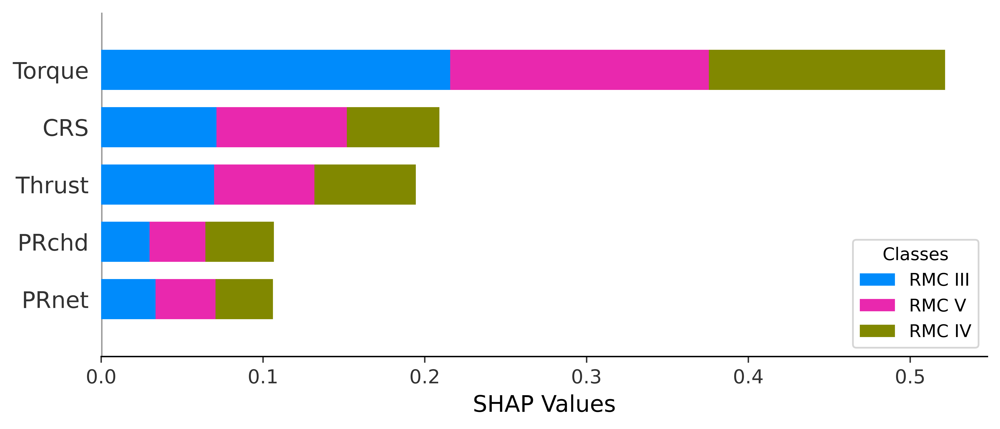

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


SHAP Summary Plot for Class III


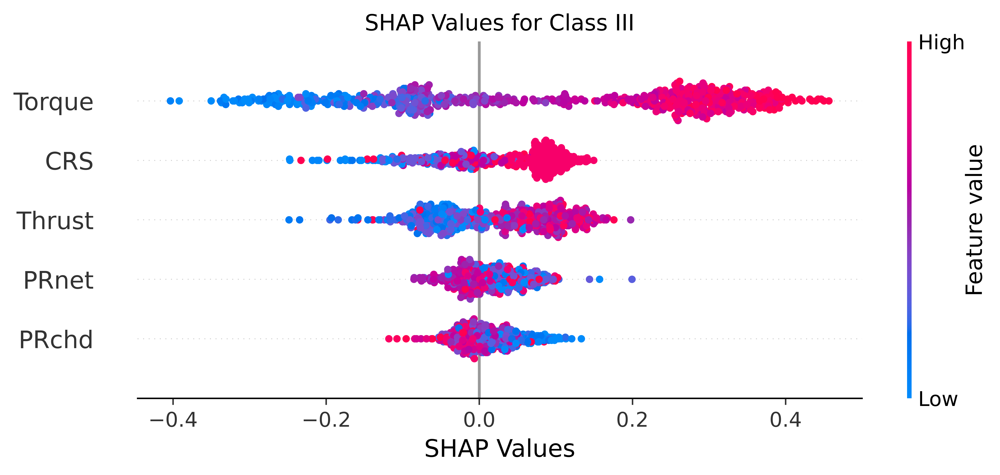

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


SHAP Summary Plot for Class IV


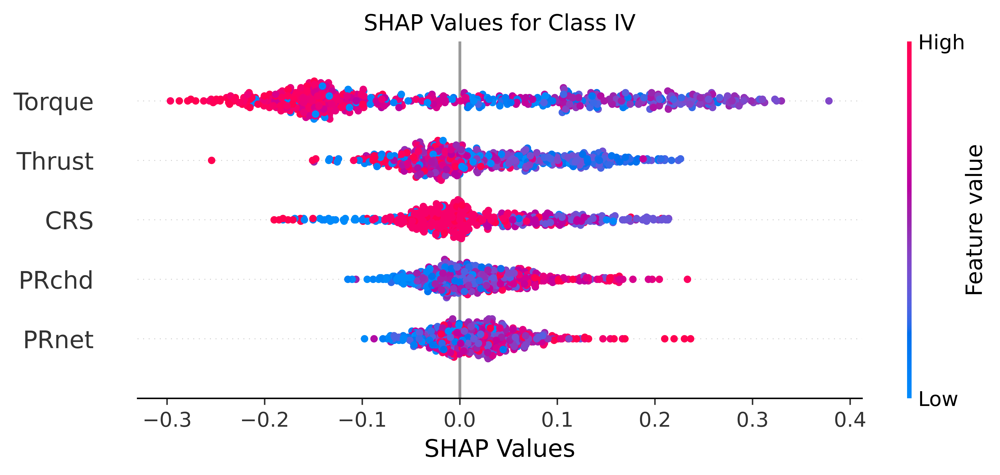

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


SHAP Summary Plot for Class V


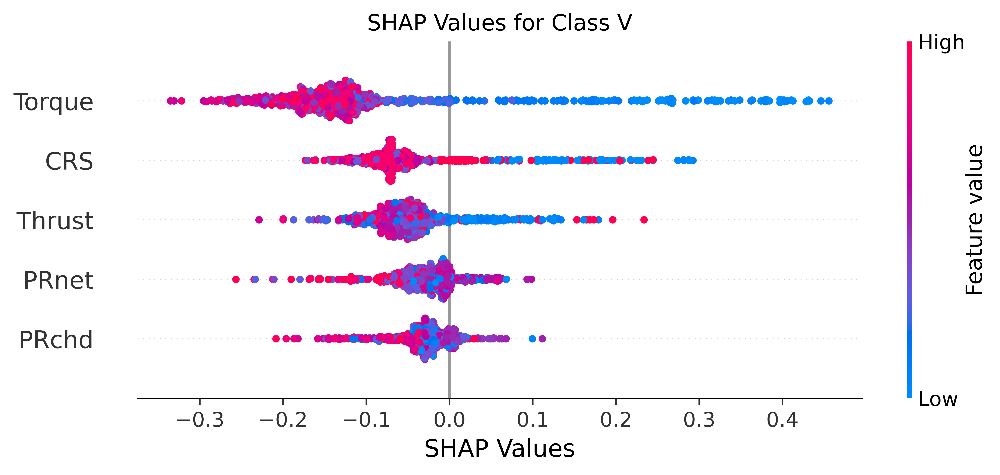

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Import SHAP library
import shap
import matplotlib.pyplot as plt
from google.colab import files  # For downloading files in Colab

# Select the Random Forest model with SMOTE for SHAP analysis
model_rf_smote = models_smote['Random Forest']

# Fit the model again on the SMOTE-resampled training data (if not already fitted)
model_rf_smote.fit(X_train_smote, y_train_smote)

# Verify the number of classes in the model
print("Classes in Random Forest model:", model_rf_smote.classes_)
print("Number of classes:", len(model_rf_smote.classes_))

# Create a SHAP explainer object
explainer = shap.TreeExplainer(model_rf_smote)

# Calculate SHAP values for the test set
shap_values = explainer.shap_values(X_test)

# Debugging: Print shapes to confirm correctness
print("Shape of X_test:", X_test.shape)
print("Type of shap_values:", type(shap_values))
print("Shape of shap_values:", shap_values.shape)  # Expect (635, 5, 3)

# Feature names for better readability in plots
feature_names = ['CRS', 'Torque', 'Thrust', 'PRchd', 'PRnet']

# Summary plot for all classes (bar plot) with custom legend labels
print("SHAP Summary Plot for Random Forest (with SMOTE) - All Classes")
plt.figure(dpi=800)  # Set DPI for the figure
shap.summary_plot(shap_values, X_test, feature_names=feature_names, plot_type="bar", show=False)

# Customize the legend labels
class_labels = ['RMC III', 'RMC IV', 'RMC V']  # Custom labels for Class 0, 1, 2
ax = plt.gca()  # Get the current axes
handles, labels = ax.get_legend_handles_labels()  # Get the current legend handles and labels
new_labels = [class_labels[int(label.split()[-1])] for label in labels]  # Map "Class 0" to "RMC III", etc.
ax.legend(handles, new_labels, title="Classes")  # Update the legend with new labels

plt.xlabel("SHAP Values")  # Change x-axis label
plt.savefig('shap_summary_all_classes.png', dpi=800, bbox_inches='tight')
plt.show()
files.download('shap_summary_all_classes.png')  # Download the file

# Class-specific SHAP summary plots
rock_mass_classes = ['Class III', 'Class IV', 'Class V']

for i, class_name in enumerate(rock_mass_classes):
    print(f"\nSHAP Summary Plot for {class_name}")
    plt.figure(dpi=800)  # Set DPI for the figure
    shap.summary_plot(shap_values[:, :, i], X_test, feature_names=feature_names, show=False)
    plt.title(f"SHAP Values for {class_name}")
    plt.xlabel("SHAP Values")  # Change x-axis label
    plt.savefig(f'shap_summary_{class_name.replace(" ", "_")}.png', dpi=800, bbox_inches='tight')
    plt.show()
    files.download(f'shap_summary_{class_name.replace(" ", "_")}.png')  # Download the file

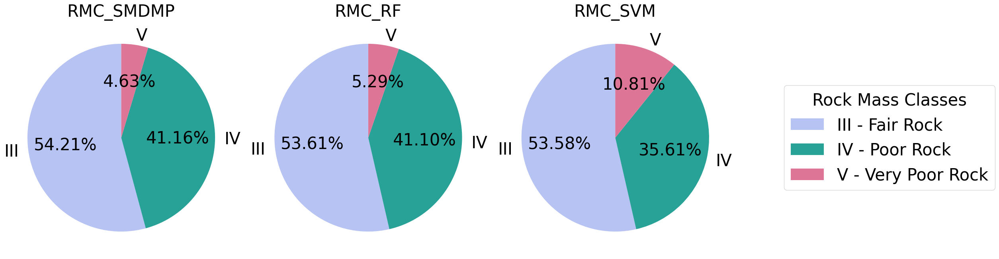

In [ ]:
import matplotlib.pyplot as plt

# Data for the three pie charts
sizes1 = [54.21, 41.16, 4.63]  # RMC_SMDMP
sizes2 = [53.61, 41.10, 5.29]  # RMC_RF
sizes3 = [53.58, 35.61, 10.81] # RMC_SVM
labels = ['III', 'IV', 'V']
colors = ['#B7C3F3', '#28A197', '#DD7596']
explode = (0, 0, 0)  # No explosion for these charts

# Create the figure with three subplots side by side
fig, axes = plt.subplots(1, 3, figsize=(22, 15))

# First pie chart (RMC_SMDMP)
wedges1, texts1, autotexts1 = axes[0].pie(
    sizes1,
    labels=labels,
    colors=colors,
    autopct='%1.2f%%',  # Show two decimal places
    explode=explode,
    startangle=90,
    textprops={'fontsize': 30}
)
axes[0].set_title("RMC_SMDMP", fontsize=30)

# Second pie chart (RMC_RF)
wedges2, texts2, autotexts2 = axes[1].pie(
    sizes2,
    labels=labels,
    colors=colors,
    autopct='%1.2f%%',  # Show two decimal places
    explode=explode,
    startangle=90,
    textprops={'fontsize': 30}
)
axes[1].set_title("RMC_RF", fontsize=30)

# Third pie chart (RMC_SVM)
wedges3, texts3, autotexts3 = axes[2].pie(
    sizes3,
    labels=labels,
    colors=colors,
    autopct='%1.2f%%',  # Show two decimal places
    explode=explode,
    startangle=90,
    textprops={'fontsize': 30}
)
axes[2].set_title("RMC_SVM", fontsize=30)

# Add a shared legend for all pie charts
fig.legend(
    loc="center right",
    fontsize=30,
    title="Rock Mass Classes",
    title_fontsize=30,
    labels=[
        "III - Fair Rock",
        "IV - Poor Rock",
        "V - Very Poor Rock"
    ],
    bbox_to_anchor=(1.15, 0.5),  # Positioning the legend to the right
    borderaxespad=0.5
)

# Ensure the pie charts are circles and adjust layout
plt.tight_layout(rect=[0, 0, 0.85, 1])  # Adjust layout to leave space for the legend

# Save the figure with high DPI
plt.savefig("three_pie_charts.png", dpi=800)
plt.show()

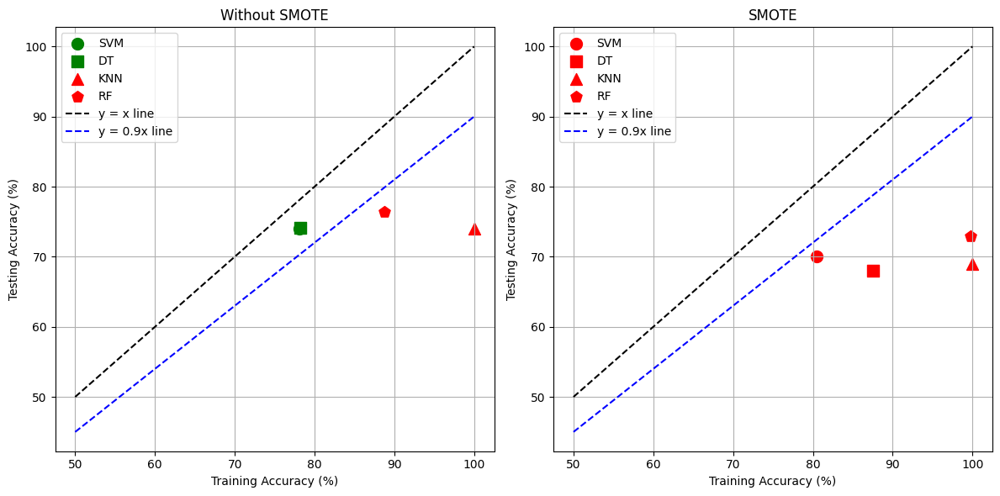

In [ ]:
import numpy as np
import matplotlib.pyplot as plt



# Train and test accuracies for each classifier (initialize example values; replace with actual accuracies)
train_accuracies_without_svmsmote = {'SVM': 78.13, 'DT': 78.25, 'KNN': 100, 'RF': 88.77}
test_accuracies_without_svmsmote = {'SVM': 74.016, 'DT': 74.17, 'KNN': 74.01, 'RF': 76.40}

train_accuracies_with_svmsmote = {'SVM': 80.499, 'DT': 87.512, 'KNN': 100, 'RF': 99.8}
test_accuracies_with_svmsmote = {'SVM': 70.079, 'DT': 68.03, 'KNN': 68.976, 'RF': 72.91}

# Prepare the data for plotting
def plot_accuracy_comparison(train_accuracies, test_accuracies, title):
    classifiers = list(train_accuracies.keys())
    train_values = list(train_accuracies.values())
    test_values = list(test_accuracies.values())

    # Define unique markers for each classifier
    markers = ['o', 's', '^', 'p']  # Ensure there are enough markers for all classifiers

    for i, classifier in enumerate(classifiers):
        # Check if the testing accuracy is within 10% of the training accuracy
        if abs(test_values[i] - train_values[i]) <= 0.1 * train_values[i]:
            color = 'green'  # Highlight in green if within 10%
        else:
            color = 'red'  # Use red otherwise

        # Plot the point with the appropriate color
        plt.scatter(train_values[i], test_values[i], label=classifier, marker=markers[i], s=100, color=color)

    # Add y = x line (perfect match) and y = 0.9x line (90% match)
    x = np.linspace(50, 100, 100)  # Adjust range based on your accuracy values
    plt.plot(x, x, 'k--', label='y = x line')  # y = x line
    plt.plot(x, 0.9 * x, 'b--', label='y = 0.9x line')  # y = 0.9x line

    plt.xlabel('Training Accuracy (%)')
    plt.ylabel('Testing Accuracy (%)')
    plt.title(title)
    plt.legend()  # Show the legend for classifiers
    plt.grid(True)

# Create subplots for both cases (With and Without SVMSMOTE)
plt.figure(figsize=(12, 6))

# Plot Without SVMSMOTE
plt.subplot(1, 2, 1)
plot_accuracy_comparison(train_accuracies_without_svmsmote, test_accuracies_without_svmsmote, 'Without SMOTE')

# Plot With SVMSMOTE
plt.subplot(1, 2, 2)
plot_accuracy_comparison(train_accuracies_with_svmsmote, test_accuracies_with_svmsmote, 'SMOTE')

plt.tight_layout()
plt.show()
